Import the below libraries for exploratory data analysis and modeling.

In [86]:
# Import all the libraries which are needed for exploratory data analysis
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
# PCA Analysis
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
#Another Solution
from sklearn.preprocessing import MinMaxScaler
%matplotlib inline

In [87]:
#Set max row display
pd.set_option('display.max_row',100)
#Set max column width to 50
pd.set_option('display.max_columns',50)

In [88]:
#Read the data
ccdefault=pd.read_csv('UCI_Credit_Card.csv')

In [89]:
#Dataset Shape
ccdefault.shape

(30000, 25)

In [90]:
#Explore the data
ccdefault.head(3)

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,-2,-2,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0


In [91]:
#rename column names
ccdefault.rename(columns={'default.payment.next.month':'DEFAULT'},inplace=True)

In [92]:
#Metadata Information
ccdefault.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
ID           30000 non-null int64
LIMIT_BAL    30000 non-null float64
SEX          30000 non-null int64
EDUCATION    30000 non-null int64
MARRIAGE     30000 non-null int64
AGE          30000 non-null int64
PAY_0        30000 non-null int64
PAY_2        30000 non-null int64
PAY_3        30000 non-null int64
PAY_4        30000 non-null int64
PAY_5        30000 non-null int64
PAY_6        30000 non-null int64
BILL_AMT1    30000 non-null float64
BILL_AMT2    30000 non-null float64
BILL_AMT3    30000 non-null float64
BILL_AMT4    30000 non-null float64
BILL_AMT5    30000 non-null float64
BILL_AMT6    30000 non-null float64
PAY_AMT1     30000 non-null float64
PAY_AMT2     30000 non-null float64
PAY_AMT3     30000 non-null float64
PAY_AMT4     30000 non-null float64
PAY_AMT5     30000 non-null float64
PAY_AMT6     30000 non-null float64
DEFAULT      30000 non-null int64
dtypes: float64

### Simple Statistics
The below statistical information, represents information from each of the column in the dataset which provide us the information on mean, min, max and how the distribution of the data. From 30k records, the credit users are in the age range from 21 to 79 years and intersting to see that the limit balance ranges from 10,000 to 1,000,000. The target variable - default has only 2 values 1 and 0, indicating that it is a classification.

In [42]:
#Statistical Information
ccdefault.describe()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,DEFAULT
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.00000,30000.000000,30000.000000,30000.000000,30000.000000
mean,15000.500000,167484.322667,1.603733,1.853133,1.551867,35.485500,-0.016700,-0.133767,-0.166200,-0.220667,-0.266200,-0.291100,51223.330900,49179.075167,4.701315e+04,43262.948967,40311.400967,38871.760400,5663.580500,5.921163e+03,5225.68150,4826.076867,4799.387633,5215.502567,0.221200
std,8660.398374,129747.661567,0.489129,0.790349,0.521970,9.217904,1.123802,1.197186,1.196868,1.169139,1.133187,1.149988,73635.860576,71173.768783,6.934939e+04,64332.856134,60797.155770,59554.107537,16563.280354,2.304087e+04,17606.96147,15666.159744,15278.305679,17777.465775,0.415062
min,1.000000,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-165580.000000,-69777.000000,-1.572640e+05,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.00000,0.000000,0.000000,0.000000,0.000000
25%,7500.750000,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,3558.750000,2984.750000,2.666250e+03,2326.750000,1763.000000,1256.000000,1000.000000,8.330000e+02,390.00000,296.000000,252.500000,117.750000,0.000000
50%,15000.500000,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,22381.500000,21200.000000,2.008850e+04,19052.000000,18104.500000,17071.000000,2100.000000,2.009000e+03,1800.00000,1500.000000,1500.000000,1500.000000,0.000000
75%,22500.250000,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,67091.000000,64006.250000,6.016475e+04,54506.000000,50190.500000,49198.250000,5006.000000,5.000000e+03,4505.00000,4013.250000,4031.500000,4000.000000,0.000000
max,30000.000000,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,964511.000000,983931.000000,1.664089e+06,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.00000,621000.000000,426529.000000,528666.000000,1.000000


### Data Quality

#### Missing Values:
The dataset does not have any missing values. The chart below provides information about all the columns in the dataset and the metrics in terms of total and percent.

In [44]:
#Check for any nulls or missing values
total = ccdefault.isnull().sum().sort_values(ascending = False)
percent = (ccdefault.isnull().sum()/ccdefault.isnull().count()*100).sort_values(ascending = False)
pd.concat([total, percent], axis=1, keys=['Total', 'Percent']).transpose()

,DEFAULT,PAY_6,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,BILL_AMT1,PAY_AMT6,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,ID
Total,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Percent,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Duplicate Values:
For identifying the duplicates, we leveraged ID column in the dataset which represents customer identification, which is the unique way to identify the record in this dataset.

There are no duplicate records based on column name ID. The below snippet and output provides the evidence.

In [34]:
#Check for duplicates
duplicateRowsDF = ccdefault[ccdefault.duplicated(['ID'])]
print("Duplicate Rows based on a single column are:", duplicateRowsDF, sep='\n')

Duplicate Rows based on a single column are:
Empty DataFrame
Columns: [ID, LIMIT_BAL, SEX, EDUCATION, MARRIAGE, AGE, PAY_0, PAY_2, PAY_3, PAY_4, PAY_5, PAY_6, BILL_AMT1, BILL_AMT2, BILL_AMT3, BILL_AMT4, BILL_AMT5, BILL_AMT6, PAY_AMT1, PAY_AMT2, PAY_AMT3, PAY_AMT4, PAY_AMT5, PAY_AMT6, DEFAULT]
Index: []


#### Outliers:


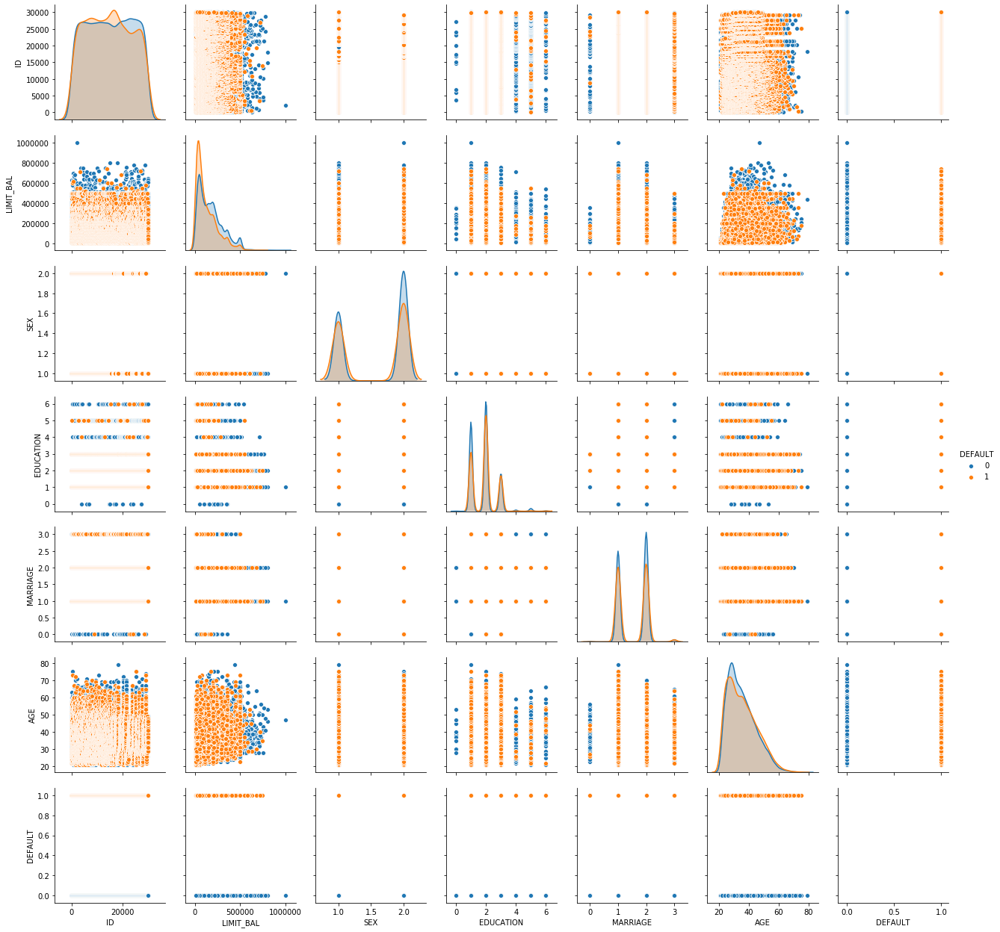

In [45]:
sns.pairplot(data=ccdefault[["ID","LIMIT_BAL","SEX","EDUCATION","MARRIAGE","AGE","DEFAULT"]],
             hue="DEFAULT", dropna=True)

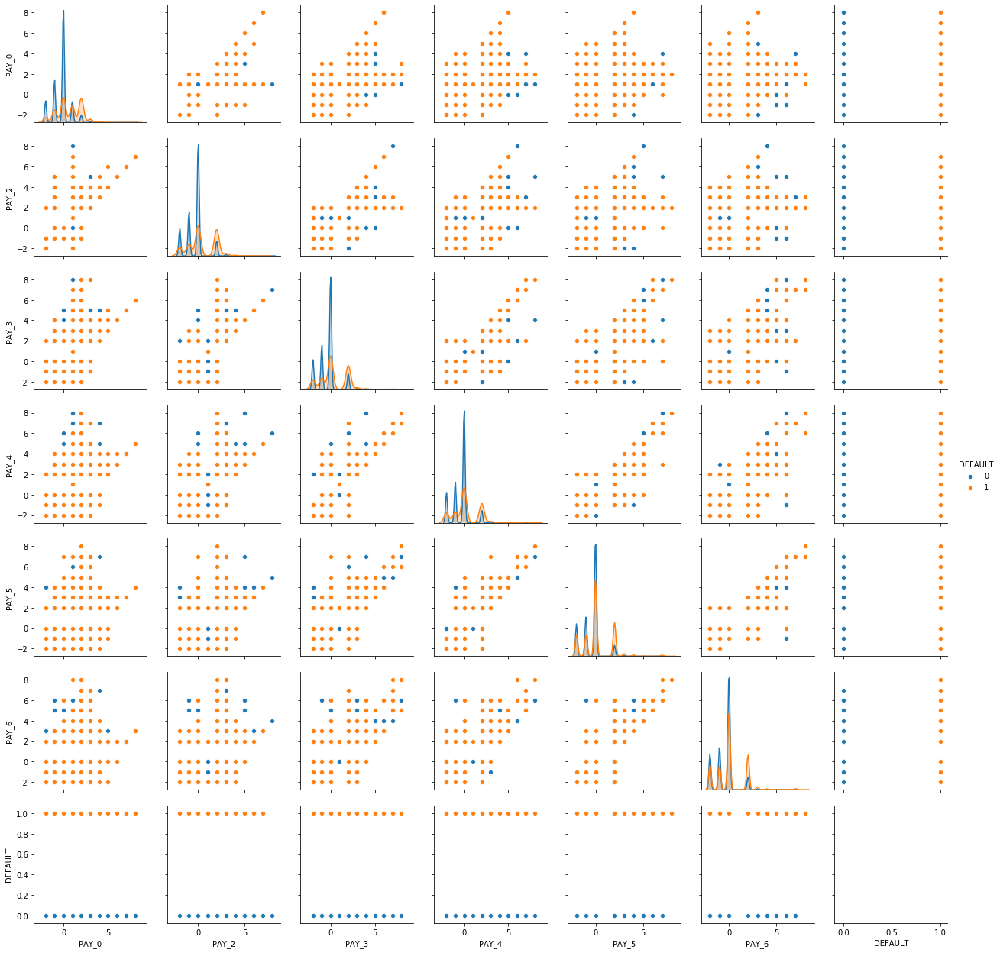

In [46]:
sns.pairplot(data=ccdefault[["PAY_0","PAY_2","PAY_3","PAY_4","PAY_5","PAY_6","DEFAULT"]],
             hue="DEFAULT", dropna=True)

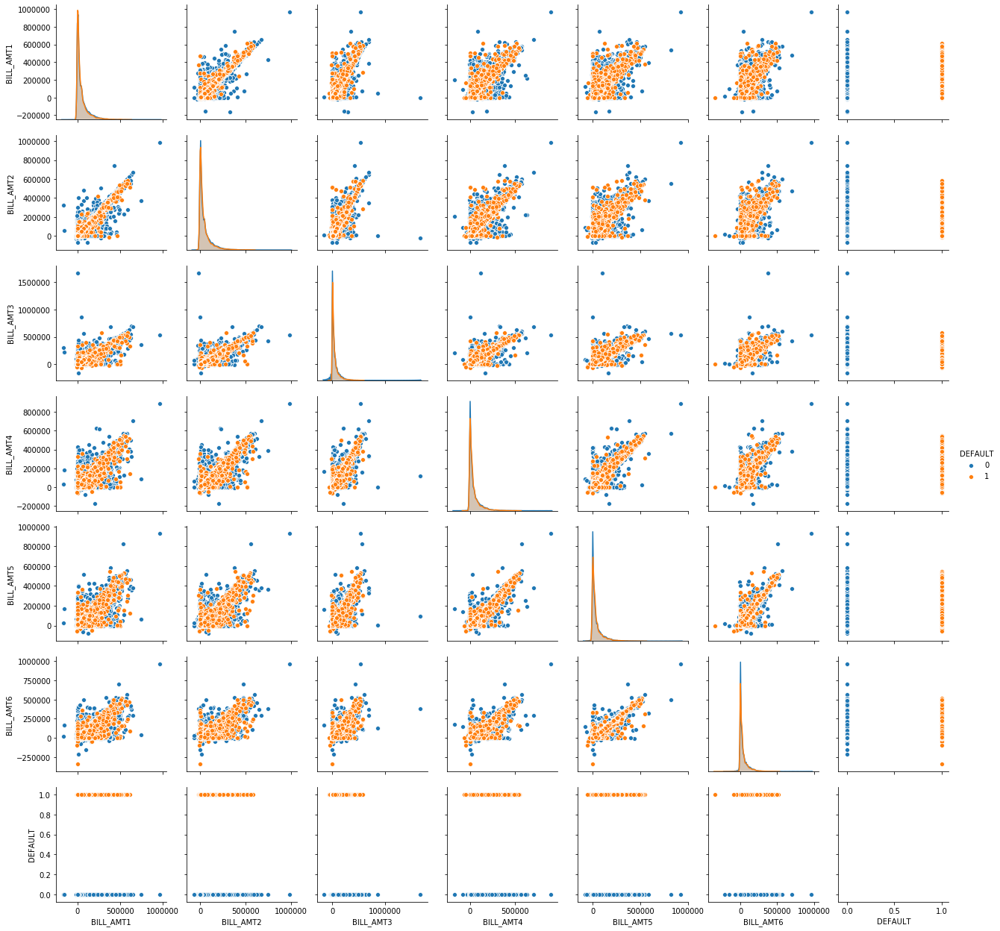

In [47]:
sns.pairplot(data=ccdefault[["BILL_AMT1","BILL_AMT2","BILL_AMT3","BILL_AMT4","BILL_AMT5","BILL_AMT6","DEFAULT"]],
             hue="DEFAULT", dropna=True)

All the bill amount columns BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6 are highl correlated with each other. The columns are continous variables and the column represent information on the bill amount for each month.

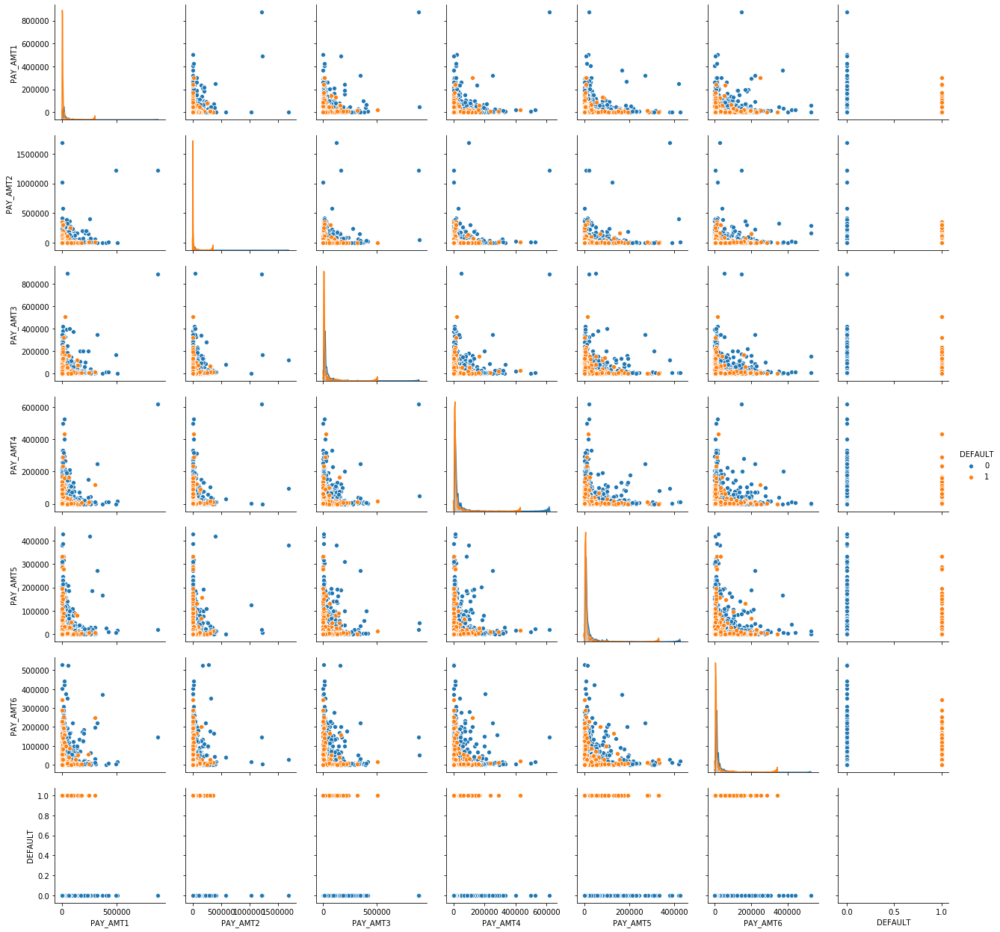

In [48]:
sns.pairplot(data=ccdefault[["PAY_AMT1","PAY_AMT2","PAY_AMT3","PAY_AMT4","PAY_AMT5","PAY_AMT6","DEFAULT"]],
             hue="DEFAULT", dropna=True)

KeyboardInterrupt: 

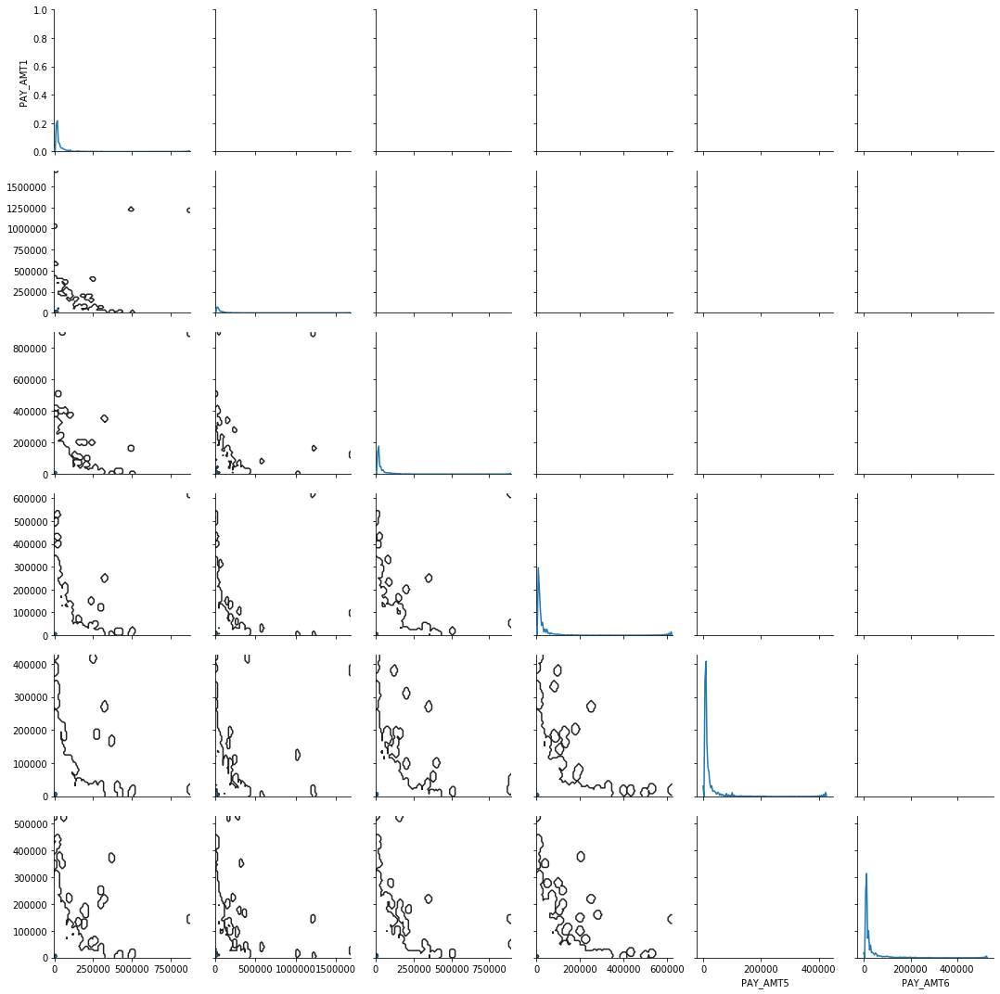

In [49]:
#Pairgrid - Pairplot is built on pairgrid
g = sns.PairGrid(data=ccdefault[["PAY_AMT1","PAY_AMT2","PAY_AMT3","PAY_AMT4","PAY_AMT5","PAY_AMT6"]])
g.map_diag(sns.kdeplot)
g.map_offdiag(sns.kdeplot, n_levels=6);

In [ ]:
# feature names as a list
col = ccdefault.columns       # .columns gives columns names in data 
print(col)

In [ ]:
# y includes our labels and x includes our features
y = ccdefault.DEFAULT

In [ ]:
ax = sns.countplot(y,label="Count")

In [ ]:
list = ['ID','DEFAULT'] # ID is removed
x = ccdefault.drop(list,axis = 1 )
x.head()

In [ ]:
# Voilin plot - First 12 features
data_dia = y
data = x
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2.iloc[:,0:12]],axis=1)
data = pd.melt(data,id_vars="DEFAULT",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="DEFAULT", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

In [ ]:
# Second 13 features
data = pd.concat([y,data_n_2.iloc[:,12:23]],axis=1)
data = pd.melt(data,id_vars="DEFAULT",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="DEFAULT", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

In [ ]:
plt.figure(figsize=(10,10))
sns.boxplot(data=ccdefault[["PAY_AMT1","PAY_AMT2","PAY_AMT3","PAY_AMT4","PAY_AMT5","PAY_AMT6"]])

In [ ]:
plt.figure(figsize=(10,10))
sns.boxplot(data=ccdefault[["BILL_AMT1","BILL_AMT2","BILL_AMT3","BILL_AMT4","BILL_AMT5","BILL_AMT6"]])

In [ ]:
plt.figure(figsize=(10,10))
sns.boxplot(data=ccdefault[["PAY_0","PAY_2","PAY_3","PAY_4","PAY_5","PAY_6"]])

Based on the data, following are the observations:
* Defaults='Yes' are on higher proportion of lower limit balance (LIMIT_BAL).
* Females,Singles,customers with age between 30-40 years are in non-default list.


In [ ]:
#SWARM PLOTS : For better visualization of distribution data
plt.figure(figsize=(12, 6))
sns.swarmplot(x="SEX", y="AGE", hue='DEFAULT', data=ccdefault,dodge=True)#, jitter=True);

In [ ]:
plt.figure(figsize=(12, 6))
sns.swarmplot(x="MARRIAGE", y="AGE", hue='DEFAULT', data=ccdefault,dodge=True)#, jitter=True);

In [ ]:
plt.figure(figsize=(12, 6))
sns.swarmplot(x="EDUCATION", y="AGE", hue='DEFAULT', data=ccdefault,dodge=True)#, jitter=True);

In [ ]:
plt.figure(figsize=(12, 6))
sns.swarmplot(x="LIMIT_BAL", y="AGE", hue='DEFAULT', data=ccdefault,dodge=True)#, jitter=True);

In [ ]:
#greater than 50,000 limit balance
grt75filter = ccdefault.LIMIT_BAL > 500000
ccdefaultgt75k=ccdefault[grt75filter]
plt.figure(figsize=(18, 6))
sns.swarmplot(x="LIMIT_BAL", y="AGE", hue='DEFAULT', data=ccdefaultgt75k,dodge=True)#, jitter=True);

In [ ]:
bins = [0,50000 , 100000, 250000, 350000,450000,1000000]
labels =[1,2,3,4,5,6]
ccdefault['binned'] = pd.cut(ccdefault['LIMIT_BAL'], bins,labels=labels)

In [ ]:
#greater than 50,000 limit balance
plt.figure(figsize=(18, 6))
sns.swarmplot(x="binned", y="AGE", hue='DEFAULT', data=ccdefault,dodge=True)#, jitter=True);

##### Bins:
    1: 0-50,000
    2: 51,000-100,000
    3: 100,001-250,000
    4: 250,001-350,000
    5: 350,001-450,000
    6: Greater than 450,000

In [ ]:
import pandas_profiling
pandas_profiling.ProfileReport(ccdefault)

In [ ]:
ccdefault.dtypes

#### PARALLEL COORDINATES

Parallel coordinates are interactive by default.In this plot with px.parallel_coordinates, each row of the DataFrame is represented by a polyline mark which traverses a set of parallel axes, one for each of the dimensions. 

In [15]:
import plotly.express as px
fig = px.parallel_coordinates(ccdefault, color='DEFAULT',
                              dimensions=['SEX', 'AGE','MARRIAGE','EDUCATION','LIMIT_BAL','PAY_0','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6','PAY_AMT1','PAY_AMT2','PAY_AMT3','PAY_AMT4','PAY_AMT5','PAY_AMT6'],
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()

In [16]:
# Verifying the data for payment columns
import plotly.express as px
fig = px.parallel_coordinates(ccdefault, color='DEFAULT',
                              dimensions=['PAY_0','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6','PAY_AMT1','PAY_AMT2','PAY_AMT3','PAY_AMT4','PAY_AMT5','PAY_AMT6'],
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()

### Exceptional Work

As a part of this lab, we spent more than 25 hours to understand the dataset and spent time researching the different visualizations which are represented in unique way like panda profiling, swarm plots and pair plots

* Swarm plots 
* Parallel Coordinates (Interactive Plot)
* Preliminary PCA Analysis
* Preliminary Logistic Regression 

#### Principle component Analysis (PCA)
PCA identifies the combination of components that account for the most variance of the data. The below initial analysis is done to identify the components. Before fitting my model, we need to standardize the numerical features and create dummies for my categorical features. In this case, we are checking with MinMaxScaler.

In [17]:
#PCA
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=[0, 1])
data_rescaled = scaler.fit_transform(ccdefault.iloc[1:, 0:24])

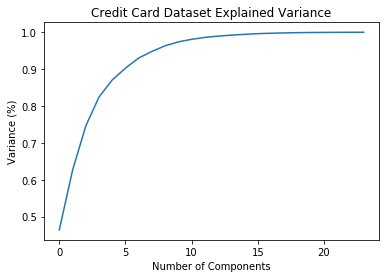

In [18]:
#Fitting the PCA algorithm with our Data
pca = PCA().fit(data_rescaled)
#Plotting the Cumulative Summation of the Explained Variance
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Credit Card Dataset Explained Variance')
plt.show()

Based on initial analysis, the plot tells us that selecting 12 components we can preserve something around 98.8% or 99% of the total variance of the data. This is a primiliminary analysis.

#### Logistic Regression


In [93]:
#Set Variables
X = ccdefault.iloc[:,:-1].values
y = ccdefault.iloc[:,-1].values

# Split the dataset 70:30 between train and test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.3,random_state = 1)



In [94]:
# Check the split
X_train.shape


(21000, 24)

In [97]:
X_test.shape

(9000, 24)

In [103]:
# Import the logistic regression from sklearn
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(random_state=1,multi_class='ovr',solver='liblinear')
logreg.fit( X_train, y_train )


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='ovr', n_jobs=None, penalty='l2', random_state=1,
                   solver='liblinear', tol=0.0001, verbose=0, warm_start=False)

In [104]:
y_pred = logreg.predict( X_test )


References
https://towardsdatascience.com/data-visualization-using-matplotlib-16f1aae5ce70